In [250]:
import os
import random
import math
import numpy as np
import matplotlib.pyplot as plt

from enum import Enum
from glob import glob
from functools import partial

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.models import Sequential
from tensorflow_addons.layers import InstanceNormalization

import tensorflow_datasets as tfds

from tqdm import tqdm

os.environ['TF_FORCE_GPU_ALLOW_GROWTH'] = 'true'

In [251]:
from __future__ import absolute_import
from __future__ import division
from __future__ import print_function

import numpy as np

from tensorflow.python.data.ops import dataset_ops
from tensorflow.python.keras.layers.preprocessing import image_preprocessing
from tensorflow.python.keras.preprocessing import dataset_utils
from tensorflow.python.ops import image_ops
from tensorflow.python.ops import io_ops
from tensorflow.python.util.tf_export import keras_export


ALLOWLIST_FORMATS = ('.bmp', '.gif', '.jpeg', '.jpg', '.png')


@keras_export('keras.preprocessing.image_dataset_from_directory', v1=[])
def image_dataset_from_directory(directory,
                                 labels='inferred',
                                 label_mode='int',
                                 class_names=None,
                                 color_mode='rgb',
                                 batch_size=32,
                                 image_size=(256, 256),
                                 shuffle=True,
                                 seed=None,
                                 validation_split=None,
                                 subset=None,
                                 interpolation='bilinear',
                                 follow_links=False):

  if labels != 'inferred':
    if not isinstance(labels, (list, tuple)):
      raise ValueError(
          '`labels` argument should be a list/tuple of integer labels, of '
          'the same size as the number of image files in the target '
          'directory. If you wish to infer the labels from the subdirectory '
          'names in the target directory, pass `labels="inferred"`. '
          'If you wish to get a dataset that only contains images '
          '(no labels), pass `label_mode=None`.')
    if class_names:
      raise ValueError('You can only pass `class_names` if the labels are '
                       'inferred from the subdirectory names in the target '
                       'directory (`labels="inferred"`).')
  if label_mode not in {'int', 'categorical', 'binary', None}:
    raise ValueError(
        '`label_mode` argument must be one of "int", "categorical", "binary", '
        'or None. Received: %s' % (label_mode,))
  if color_mode == 'rgb':
    num_channels = 3
  elif color_mode == 'rgba':
    num_channels = 4
  elif color_mode == 'grayscale':
    num_channels = 1
  else:
    raise ValueError(
        '`color_mode` must be one of {"rbg", "rgba", "grayscale"}. '
        'Received: %s' % (color_mode,))
  interpolation = image_preprocessing.get_interpolation(interpolation)
  dataset_utils.check_validation_split_arg(
      validation_split, subset, shuffle, seed)

  if seed is None:
    seed = np.random.randint(1e6)
  image_paths, labels, class_names = dataset_utils.index_directory(
      directory,
      labels,
      formats=ALLOWLIST_FORMATS,
      class_names=class_names,
      shuffle=shuffle,
      seed=seed,
      follow_links=follow_links)

  if label_mode == 'binary' and len(class_names) != 2:
    raise ValueError(
        'When passing `label_mode="binary", there must exactly 2 classes. '
        'Found the following classes: %s' % (class_names,))

  image_paths, labels = dataset_utils.get_training_or_validation_split(
      image_paths, labels, validation_split, subset)

  dataset = paths_and_labels_to_dataset(
      image_paths=image_paths,
      image_size=image_size,
      num_channels=num_channels,
      labels=labels,
      label_mode=label_mode,
      num_classes=len(class_names),
      interpolation=interpolation)
  if shuffle:
    # Shuffle locally at each iteration
    dataset = dataset.shuffle(buffer_size=batch_size * 8, seed=seed)
  dataset = dataset.batch(batch_size,drop_remainder=True)
  # Users may need to reference `class_names`.
  dataset.class_names = class_names
  # Include file paths for images as attribute.
  dataset.file_paths = image_paths
  return dataset


def paths_and_labels_to_dataset(image_paths,
                                image_size,
                                num_channels,
                                labels,
                                label_mode,
                                num_classes,
                                interpolation):
  """Constructs a dataset of images and labels."""
  # TODO(fchollet): consider making num_parallel_calls settable
  path_ds = dataset_ops.Dataset.from_tensor_slices(image_paths)
  img_ds = path_ds.map(
      lambda x: path_to_image(x, image_size, num_channels, interpolation))
  if label_mode:
    label_ds = dataset_utils.labels_to_dataset(labels, label_mode, num_classes)
    img_ds = dataset_ops.Dataset.zip((img_ds, label_ds))
  return img_ds


def path_to_image(path, image_size, num_channels, interpolation):
  img = io_ops.read_file(path)
  img = image_ops.decode_image(
      img, channels=num_channels, expand_animations=False)
  img = image_ops.resize_images_v2(img, image_size, method=interpolation)
  img.set_shape((image_size[0], image_size[1], num_channels))
  return img

In [252]:
def log2(x):
    return int(np.log2(x))


# we use different batch size for different resolution, so larger image size
# could fit into GPU memory. The keys is image resolution in log2
batch_sizes = {0:64, 1:32, 2: 16, 3: 16, 4: 16, 5: 16, 6: 16, 7: 8, 8: 4, 9: 2, 10: 1}
# We adjust the train step accordingly
train_step_ratio = {k: batch_sizes[2] / v for k, v in batch_sizes.items()}


# ds_train = tfds.load("celeb_a", split="train")


# def resize_image(res, sample):
#     image = sample["image"]
#     # only donwsampling, so use nearest neighbor that is faster to run
#     image = tf.image.resize(
#         image, (res, res), method=tf.image.ResizeMethod.NEAREST_NEIGHBOR
#     )
#     image = tf.cast(image, tf.float32) / 127.5 - 1.0
#     return image

# def resize_image2(res, image):
#     image = tf.image.resize(
#         image, (res, res), method=tf.image.ResizeMethod.NEAREST_NEIGHBOR
#     )
#     image = tf.cast(image, tf.float32) / 127.5 - 1.0
#     return image

def normalization(image):
    image = image/127.5-1.
    return tf.image.random_flip_left_right(image)

def create_dataloader(res):
    batch_size = batch_sizes[log2(res)]
#     dl = ds_train.map(partial(resize_image, res), num_parallel_calls=tf.data.AUTOTUNE)
#     dl = dl.shuffle(200).batch(batch_size, drop_remainder=True).prefetch(1).repeat()
#     return dl
#     resized = tf.image.resize(all_image_tensor, (res, res), method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)
#     return tf.data.Dataset.from_tensors(resized).shuffle(200)
#     im_gen = tf.keras.preprocessing.image.ImageDataGenerator(
#         rescale=1./255,
#         shear_range=0.2,
#         zoom_range=0.2,
#         horizontal_flip=True)
#     print(batch_size)
    return image_dataset_from_directory("./data3",image_size=(res,res),batch_size=batch_size,label_mode=None).map(normalization).repeat()

In [253]:
def plot_images(images, log2_res, fname=""):
    scales = {1: 0.5, 2: 0.5, 3: 1, 4: 2, 5: 3, 6: 4, 7: 5, 8: 6, 9: 7, 10: 8}
    scale = scales[log2_res]

    grid_col = min(images.shape[0], int(32 // scale))
    grid_row = 1

    f, axarr = plt.subplots(
        grid_row, grid_col, figsize=(grid_col * scale, grid_row * scale)
    )

    for row in range(grid_row):
        ax = axarr if grid_row == 1 else axarr[row]
        for col in range(grid_col):
            ax[col].imshow(images[row * grid_col + col])
            ax[col].axis("off")
    plt.show()
    if fname:
        f.savefig(fname)

In [254]:
def fade_in(alpha, a, b):
    return alpha * a + (1.0 - alpha) * b


def wasserstein_loss(y_true, y_pred):
    return -tf.reduce_mean(y_true * y_pred)


def pixel_norm(x, epsilon=1e-8):
    return x / tf.math.sqrt(tf.reduce_mean(x ** 2, axis=-1, keepdims=True) + epsilon)


def minibatch_std(input_tensor, epsilon=1e-8):
    n, h, w, c = tf.shape(input_tensor)
    group_size = tf.minimum(4, n)
    x = tf.reshape(input_tensor, [group_size, -1, h, w, c])
    group_mean, group_var = tf.nn.moments(x, axes=(0), keepdims=False)
    group_std = tf.sqrt(group_var + epsilon)
    avg_std = tf.reduce_mean(group_std, axis=[1, 2, 3], keepdims=True)
    x = tf.tile(avg_std, [group_size, h, w, 1])
    return tf.concat([input_tensor, x], axis=-1)


class EqualizedConv(layers.Layer):
    def __init__(self, out_channels, kernel=3, gain=2, **kwargs):
        super(EqualizedConv, self).__init__(**kwargs)
        self.kernel = kernel
        self.out_channels = out_channels
        self.gain = gain
        self.pad = kernel != 1

    def build(self, input_shape):
        self.in_channels = input_shape[-1]
        initializer = keras.initializers.RandomNormal(mean=0.0, stddev=1.0)
        self.w = self.add_weight(
            shape=[self.kernel, self.kernel, self.in_channels, self.out_channels],
            initializer=initializer,
            trainable=True,
            name="kernel",
        )
        self.b = self.add_weight(
            shape=(self.out_channels,), initializer="zeros", trainable=True, name="bias"
        )
        fan_in = self.kernel * self.kernel * self.in_channels
        self.scale = tf.sqrt(self.gain / fan_in)

    def call(self, inputs):
        if self.pad:
            x = tf.pad(inputs, [[0, 0], [1, 1], [1, 1], [0, 0]], mode="REFLECT")
        else:
            x = inputs
        output = (
            tf.nn.conv2d(x, self.scale * self.w, strides=1, padding="VALID") + self.b
        )
        return output


class EqualizedDense(layers.Layer):
    def __init__(self, units, gain=2, learning_rate_multiplier=1, **kwargs):
        super(EqualizedDense, self).__init__(**kwargs)
        self.units = units
        self.gain = gain
        self.learning_rate_multiplier = learning_rate_multiplier

    def build(self, input_shape):
        self.in_channels = input_shape[-1]
        initializer = keras.initializers.RandomNormal(
            mean=0.0, stddev=1.0 / self.learning_rate_multiplier
        )
        self.w = self.add_weight(
            shape=[self.in_channels, self.units],
            initializer=initializer,
            trainable=True,
            name="kernel",
        )
        self.b = self.add_weight(
            shape=(self.units,), initializer="zeros", trainable=True, name="bias"
        )
        fan_in = self.in_channels
        self.scale = tf.sqrt(self.gain / fan_in)

    def call(self, inputs):
        output = tf.add(tf.matmul(inputs, self.scale * self.w), self.b)
        return output * self.learning_rate_multiplier


class AddNoise(layers.Layer):
    def build(self, input_shape):
        n, h, w, c = input_shape[0]
        initializer = keras.initializers.RandomNormal(mean=0.0, stddev=1.0)
        self.b = self.add_weight(
            shape=[1, 1, 1, c], initializer=initializer, trainable=True, name="kernel"
        )

    def call(self, inputs):
        x, noise = inputs
        output = x + self.b * noise
        return output


class AdaIN(layers.Layer):
    def __init__(self, gain=1, **kwargs):
        super(AdaIN, self).__init__(**kwargs)
        self.gain = gain

    def build(self, input_shapes):
        x_shape = input_shapes[0]
        w_shape = input_shapes[1]

        self.w_channels = w_shape[-1]
        self.x_channels = x_shape[-1]

        self.dense_1 = EqualizedDense(self.x_channels, gain=1)
        self.dense_2 = EqualizedDense(self.x_channels, gain=1)

    def call(self, inputs):
        x, w = inputs
        ys = tf.reshape(self.dense_1(w), (-1, 1, 1, self.x_channels))
        yb = tf.reshape(self.dense_2(w), (-1, 1, 1, self.x_channels))
        return ys * x + yb

In [255]:
map_defualt_size = 128

def Mapping(num_stages, input_shape=map_defualt_size):
    z = layers.Input(shape=(input_shape))
    w = pixel_norm(z)
    for i in range(3):
        w = EqualizedDense(input_shape, learning_rate_multiplier=0.01)(w)
        w = layers.LeakyReLU(0.2)(w)
    w = tf.tile(tf.expand_dims(w, 1), (1, num_stages, 1))
    print(w.shape)
    return keras.Model(z, w, name="mapping")

def Mapping2(num_stages, input_shape=512):
    z = layers.Input(shape=(input_shape))
    w = pixel_norm(z)
    for i in range(8):
        w = layers.Dense(512)(w)
        w = layers.LeakyReLU(0.2)(w)
    w = tf.tile(tf.expand_dims(w, 1), (1, num_stages, 1))
    return keras.Model(z, w, name="mapping")

def Mapping4(num_stages, input_shape=map_defualt_size):
    z = layers.Input(shape=(input_shape))
    w = pixel_norm(z)
    temp_ws = tf.constant([])
    it = 0
    for i in range(num_stages):
        temp_w = layers.Dense(input_shape*2)(w)
        temp_w = layers.LeakyReLU(0.2)(temp_w)
        if it!=0:
            temp_ws = tf.concat((temp_ws, tf.expand_dims(temp_w, 1)),axis = 1)
        else:
            it=1
            temp_ws = tf.expand_dims(temp_w, 1)
        temp_wt = layers.Dense(input_shape)(temp_w)
        temp_wt = layers.LeakyReLU(0.2)(temp_wt)
        w = layers.Concatenate()([temp_wt, w])
#     w = tf.tile(tf.expand_dims(w, 1), (1, num_stages, 1))
    print(temp_ws.shape)
    return keras.Model(z, temp_ws, name="mapping")

def Mapping4(num_stages, input_shape=map_defualt_size):
    z = layers.Input(shape=(input_shape))
    w = pixel_norm(z)
    temp_ws = tf.constant([])
    it = 0
    for i in range(num_stages):
        temp_w = layers.Dense(input_shape*2)(w)
        temp_w = layers.LeakyReLU(0.2)(temp_w)
        if it!=0:
            temp_ws = tf.concat((temp_ws, tf.expand_dims(temp_w, 1)),axis = 1)
        else:
            it=1
            temp_ws = tf.expand_dims(temp_w, 1)
        w = layers.Concatenate()([temp_w, w])
        w = layers.Dense(input_shape)(w)
        w = layers.LeakyReLU(0.2)(w)
#     w = tf.tile(tf.expand_dims(w, 1), (1, num_stages, 1))
    print(temp_ws.shape)
    return keras.Model(z, temp_ws, name="mapping")


class Generator:
    def __init__(self, start_res_log2, target_res_log2):
        self.start_res_log2 = start_res_log2
        self.target_res_log2 = target_res_log2
        self.num_stages = target_res_log2 - start_res_log2 + 1
        # list of generator blocks at increasing resolution
        self.g_blocks = []
        # list of layers to convert g_block activation to RGB
        self.to_rgb = []
        # list of noise input of different resolutions into g_blocks
        self.noise_inputs = []
        # filter size to use at each stage, keys are log2(resolution)
        self.filter_nums = {
            0: 512,
            1: 512,
            2: 512,  # 4x4
            3: 256,  # 8x8
            4: 128,  # 16x16
            5: 64,  # 32x32
            6: 32,  # 64x64
            7: 128,  # 128x128
            8: 64,  # 256x256
            9: 32,  # 512x512
            10: 16,
        }  # 1024x1024

        start_res = 2 ** start_res_log2
        self.input_shape = (start_res, start_res, self.filter_nums[start_res_log2])
        self.g_input = layers.Input(self.input_shape, name="generator_input")

        for i in range(start_res_log2, target_res_log2 + 1):
            filter_num = self.filter_nums[i]
            res = 2 ** i
            self.noise_inputs.append(
                layers.Input(shape=(res, res, 1), name=f"noise_{res}x{res}")
            )
            to_rgb = Sequential(
                [
                    layers.InputLayer(input_shape=(res, res, filter_num)),
                    EqualizedConv(3, 1, gain=1),
                ],
                name=f"to_rgb_{res}x{res}",
            )
            self.to_rgb.append(to_rgb)
            is_base = i == self.start_res_log2
            if is_base:
                input_shape = (res, res, self.filter_nums[i - 1])
            else:
                input_shape = (2 ** (i - 1), 2 ** (i - 1), self.filter_nums[i - 1])
            g_block = self.build_block(
                filter_num, res=res, input_shape=input_shape, is_base=is_base
            )
            self.g_blocks.append(g_block)

    def build_block(self, filter_num, res, input_shape, is_base):
        input_tensor = layers.Input(shape=input_shape, name=f"g_{res}")
        noise = layers.Input(shape=(res, res, 1), name=f"noise_{res}")
        w = layers.Input(shape=map_defualt_size*2)
        x = input_tensor

        if not is_base:
            x = layers.UpSampling2D((2, 2))(x)
            x = EqualizedConv(filter_num, 3)(x)

        x = AddNoise()([x, noise])
        x = layers.LeakyReLU(0.2)(x)
        x = InstanceNormalization()(x)
        x = AdaIN()([x, w])

        #here
#         x = EqualizedConv(filter_num, 3)(x)
#         x = AddNoise()([x, noise])
#         x = layers.LeakyReLU(0.2)(x)
#         x = InstanceNormalization()(x)
#         x = AdaIN()([x, w])
        
        x = EqualizedConv(filter_num, 3)(x)
        x = AddNoise()([x, noise])
        x = layers.LeakyReLU(0.2)(x)
        x = InstanceNormalization()(x)
        x = AdaIN()([x, w])
        return keras.Model([input_tensor, w, noise], x, name=f"genblock_{res}x{res}")

    def grow(self, res_log2):
        res = 2 ** res_log2

        num_stages = res_log2 - self.start_res_log2 + 1
        w = layers.Input(shape=(self.num_stages, map_defualt_size*2), name="w")

        alpha = layers.Input(shape=(1), name="g_alpha")
        x = self.g_blocks[0]([self.g_input, w[:, 0], self.noise_inputs[0]])

        if num_stages == 1:
            rgb = self.to_rgb[0](x)
        else:
            for i in range(1, num_stages - 1):

                x = self.g_blocks[i]([x, w[:, i], self.noise_inputs[i]])

            old_rgb = self.to_rgb[num_stages - 2](x)
            old_rgb = layers.UpSampling2D((2, 2))(old_rgb)

            i = num_stages - 1
            x = self.g_blocks[i]([x, w[:, i], self.noise_inputs[i]])

            new_rgb = self.to_rgb[i](x)

            rgb = fade_in(alpha[0], new_rgb, old_rgb)

        return keras.Model(
            [self.g_input, w, self.noise_inputs, alpha],
            rgb,
            name=f"generator_{res}_x_{res}",
        )


class Discriminator:
    def __init__(self, start_res_log2, target_res_log2):
        self.start_res_log2 = start_res_log2
        self.target_res_log2 = target_res_log2
        self.num_stages = target_res_log2 - start_res_log2 + 1
        # filter size to use at each stage, keys are log2(resolution)
        self.filter_nums = {
            0: 512,
            1: 512,
            2: 512,  # 4x4
            3: 256,  # 8x8
            4: 128,  # 16x16
            5: 64,  # 32x32
            6: 32,  # 64x64
            7: 128,  # 128x128
            8: 64,  # 256x256
            9: 32,  # 512x512
            10: 16,
        }  # 1024x1024
        # list of discriminator blocks at increasing resolution
        self.d_blocks = []
        # list of layers to convert RGB into activation for d_blocks inputs
        self.from_rgb = []

        for res_log2 in range(self.start_res_log2, self.target_res_log2 + 1):
            res = 2 ** res_log2
            filter_num = self.filter_nums[res_log2]
            from_rgb = Sequential(
                [
                    layers.InputLayer(
                        input_shape=(res, res, 3), name=f"from_rgb_input_{res}"
                    ),
                    EqualizedConv(filter_num, 1),
                    layers.LeakyReLU(0.2),
                ],
                name=f"from_rgb_{res}",
            )

            self.from_rgb.append(from_rgb)

            input_shape = (res, res, filter_num)
            if len(self.d_blocks) == 0:
                d_block = self.build_base(filter_num, res)
            else:
                d_block = self.build_block(
                    filter_num, self.filter_nums[res_log2 - 1], res
                )

            self.d_blocks.append(d_block)

    def build_base(self, filter_num, res):
        input_tensor = layers.Input(shape=(res, res, filter_num), name=f"d_{res}")
        x = minibatch_std(input_tensor)
        x = EqualizedConv(filter_num, 3)(x)
        x = layers.LeakyReLU(0.2)(x)
        x = layers.Flatten()(x)
        x = EqualizedDense(filter_num)(x)
        x = layers.LeakyReLU(0.2)(x)
        x = EqualizedDense(1)(x)
        return keras.Model(input_tensor, x, name=f"d_{res}")

    def build_block(self, filter_num_1, filter_num_2, res):
        input_tensor = layers.Input(shape=(res, res, filter_num_1), name=f"d_{res}")
        x = EqualizedConv(filter_num_1, 3)(input_tensor)
        x = layers.LeakyReLU(0.2)(x)
        x = EqualizedConv(filter_num_2)(x)
        x = layers.LeakyReLU(0.2)(x)
        x = layers.AveragePooling2D((2, 2))(x)
        return keras.Model(input_tensor, x, name=f"d_{res}")

    def grow(self, res_log2):
        res = 2 ** res_log2
        idx = res_log2 - self.start_res_log2
        alpha = layers.Input(shape=(1), name="d_alpha")
        input_image = layers.Input(shape=(res, res, 3), name="input_image")
        x = self.from_rgb[idx](input_image)
        x = self.d_blocks[idx](x)
        if idx > 0:
            idx -= 1
            downsized_image = layers.AveragePooling2D((2, 2))(input_image)
            y = self.from_rgb[idx](downsized_image)
            x = fade_in(alpha[0], x, y)

            for i in range(idx, -1, -1):
                x = self.d_blocks[i](x)
        return keras.Model([input_image, alpha], x, name=f"discriminator_{res}_x_{res}")

In [256]:
class StyleGAN(tf.keras.Model):
    def __init__(self, z_dim=map_defualt_size, target_res=64, start_res=4):
        super(StyleGAN, self).__init__()
        self.z_dim = z_dim

        self.target_res_log2 = log2(target_res)
        self.start_res_log2 = log2(start_res)
        self.current_res_log2 = self.target_res_log2
        self.num_stages = self.target_res_log2 - self.start_res_log2 + 1

        self.alpha = tf.Variable(1.0, dtype=tf.float32, trainable=False, name="alpha")

        self.mapping = Mapping4(num_stages=self.num_stages)
        self.d_builder = Discriminator(self.start_res_log2, self.target_res_log2)
        self.g_builder = Generator(self.start_res_log2, self.target_res_log2)
        self.g_input_shape = self.g_builder.input_shape

        self.phase = None
        self.train_step_counter = tf.Variable(0, dtype=tf.int32, trainable=False)

        self.loss_weights = {"gradient_penalty": 10, "drift": 0.001}

    def grow_model(self, res):
        tf.keras.backend.clear_session()
        res_log2 = log2(res)
        self.generator = self.g_builder.grow(res_log2)
        self.discriminator = self.d_builder.grow(res_log2)
        self.current_res_log2 = res_log2
        print(f"\nModel resolution:{res}x{res}")

    def compile(
        self, steps_per_epoch, phase, res, d_optimizer, g_optimizer, *args, **kwargs
    ):
        self.loss_weights = kwargs.pop("loss_weights", self.loss_weights)
        self.steps_per_epoch = steps_per_epoch
        if res != 2 ** self.current_res_log2:
            self.grow_model(res)
            self.d_optimizer = d_optimizer
            self.g_optimizer = g_optimizer

        self.train_step_counter.assign(0)
        self.phase = phase
        self.d_loss_metric = keras.metrics.Mean(name="d_loss")
        self.g_loss_metric = keras.metrics.Mean(name="g_loss")
        super(StyleGAN, self).compile(*args, **kwargs)

    @property
    def metrics(self):
        return [self.d_loss_metric, self.g_loss_metric]

    def generate_noise(self, batch_size):
        noise = [
            tf.random.normal((batch_size, 2 ** res, 2 ** res, 1))
            for res in range(self.start_res_log2, self.target_res_log2 + 1)
        ]
        return noise

    def gradient_loss(self, grad):
        loss = tf.square(grad)
        loss = tf.reduce_sum(loss, axis=tf.range(1, tf.size(tf.shape(loss))))
        loss = tf.sqrt(loss)
        loss = tf.reduce_mean(tf.square(loss - 1))
        return loss

    def train_step(self, real_images):
        
        self.train_step_counter.assign_add(1)

        if self.phase == "TRANSITION":
            self.alpha.assign(
                tf.cast(self.train_step_counter / self.steps_per_epoch, tf.float32)
            )
        elif self.phase == "STABLE":
            self.alpha.assign(1.0)
        else:
            raise NotImplementedError
        alpha = tf.expand_dims(self.alpha, 0)
        batch_size = tf.shape(real_images)[0]
        real_labels = tf.ones(batch_size)
        fake_labels = -tf.ones(batch_size)

        z = tf.random.normal((batch_size, self.z_dim))
        const_input = tf.ones(tuple([batch_size] + list(self.g_input_shape)))
        noise = self.generate_noise(batch_size)

        # generator
        with tf.GradientTape() as g_tape:
            w = self.mapping(z)
            fake_images = self.generator([const_input, w, noise, alpha])
            pred_fake = self.discriminator([fake_images, alpha])
            g_loss = wasserstein_loss(real_labels, pred_fake)

            trainable_weights = (
                self.mapping.trainable_weights + self.generator.trainable_weights
            )
            gradients = g_tape.gradient(g_loss, trainable_weights)
            self.g_optimizer.apply_gradients(zip(gradients, trainable_weights))

        # discriminator
        with tf.GradientTape() as gradient_tape, tf.GradientTape() as total_tape:
            # forward pass
            pred_fake = self.discriminator([fake_images, alpha])
            pred_real = self.discriminator([real_images, alpha])

            epsilon = tf.random.uniform((batch_size, 1, 1, 1))
            interpolates = epsilon * real_images + (1 - epsilon) * fake_images
            gradient_tape.watch(interpolates)
            pred_fake_grad = self.discriminator([interpolates, alpha])

            # calculate losses
            loss_fake = wasserstein_loss(fake_labels, pred_fake)
            loss_real = wasserstein_loss(real_labels, pred_real)
            loss_fake_grad = wasserstein_loss(fake_labels, pred_fake_grad)

            # gradient penalty
            gradients_fake = gradient_tape.gradient(loss_fake_grad, [interpolates])
            gradient_penalty = self.loss_weights[
                "gradient_penalty"
            ] * self.gradient_loss(gradients_fake)

            # drift loss
            all_pred = tf.concat([pred_fake, pred_real], axis=0)
            drift_loss = self.loss_weights["drift"] * tf.reduce_mean(all_pred ** 2)

            d_loss = loss_fake + loss_real + gradient_penalty + drift_loss

            gradients = total_tape.gradient(
                d_loss, self.discriminator.trainable_weights
            )
            self.d_optimizer.apply_gradients(
                zip(gradients, self.discriminator.trainable_weights)
            )

        # Update metrics
        self.d_loss_metric.update_state(d_loss)
        self.g_loss_metric.update_state(g_loss)
        return {
            "d_loss": self.d_loss_metric.result(),
            "g_loss": self.g_loss_metric.result(),
        }

    def call(self, inputs: dict()):
        style_code = inputs.get("style_code", None)
        z = inputs.get("z", None)
        noise = inputs.get("noise", None)
        batch_size = inputs.get("batch_size", 1)
        alpha = inputs.get("alpha", 1.0)
        alpha = tf.expand_dims(alpha, 0)
        if style_code is None:
            if z is None:
                z = tf.random.normal((batch_size, self.z_dim))
            style_code = self.mapping(z)

        if noise is None:
            noise = self.generate_noise(batch_size)

        # self.alpha.assign(alpha)

        const_input = tf.ones(tuple([batch_size] + list(self.g_input_shape)))
        images = self.generator([const_input, style_code, noise, alpha])
        images = np.clip((images * 0.5 + 0.5) * 255, 0, 255).astype(np.uint8)

        return images

In [257]:
START_RES = 4
TARGET_RES = 64

style_gan = StyleGAN(start_res=START_RES, target_res=TARGET_RES)

(None, 5, 256)


In [258]:
def train(
    start_res=START_RES,
    target_res=TARGET_RES,
    steps_per_epoch=5000,
    display_images=True,
):
    opt_cfg = {"learning_rate": 1e-3, "beta_1": 0.0, "beta_2": 0.99, "epsilon": 1e-8}

    val_batch_size = 16
    val_z = tf.random.normal((val_batch_size, style_gan.z_dim))
    val_noise = style_gan.generate_noise(val_batch_size)

    start_res_log2 = int(np.log2(start_res))
    target_res_log2 = int(np.log2(target_res))

    for res_log2 in range(start_res_log2, target_res_log2 + 1):
        res = 2 ** res_log2
        for phase in ["TRANSITION", "STABLE"]:
            if res == start_res and phase == "TRANSITION":
                continue

            train_dl = create_dataloader(res)

            steps = int(train_step_ratio[res_log2] * steps_per_epoch)

            style_gan.compile(
                d_optimizer=tf.keras.optimizers.Adam(**opt_cfg),
                g_optimizer=tf.keras.optimizers.Adam(**opt_cfg),
                loss_weights={"gradient_penalty": 10, "drift": 0.001},
                steps_per_epoch=steps,
                res=res,
                phase=phase,
                run_eagerly=False,
            )

            prefix = f"res_{res}x{res}_{style_gan.phase}"

            ckpt_cb = keras.callbacks.ModelCheckpoint(
                f"checkpoints/stylegan_{res}x{res}.ckpt",
                save_weights_only=True,
                verbose=0,
            )
            print(phase)
#             print(train_dl)
            style_gan.fit(
                train_dl, epochs=1, steps_per_epoch=steps, callbacks=[ckpt_cb]
            )

            if display_images:
                images = style_gan({"z": val_z, "noise": val_noise, "alpha": 1.0})
                plot_images(images, res_log2)

Found 306 files belonging to 1 classes.

Model resolution:4x4
STABLE
5000/5000 [==============================] - 494s 98ms/step - d_loss: -4.1353 - g_loss: 2.7437


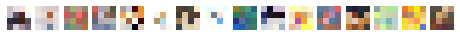

Found 306 files belonging to 1 classes.

Model resolution:8x8
TRANSITION
5000/5000 [==============================] - 583s 115ms/step - d_loss: -6.3039 - g_loss: 4.8827


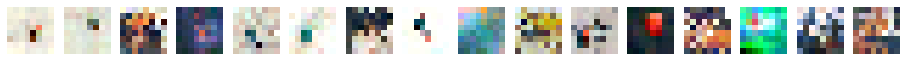

Found 306 files belonging to 1 classes.
STABLE
5000/5000 [==============================] - 566s 112ms/step - d_loss: -10.5441 - g_loss: 5.9377


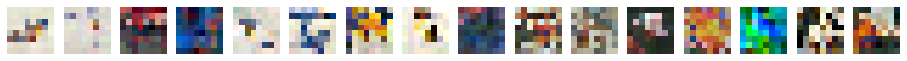

Found 306 files belonging to 1 classes.

Model resolution:16x16
TRANSITION
5000/5000 [==============================] - 682s 135ms/step - d_loss: -16.1582 - g_loss: 12.1902


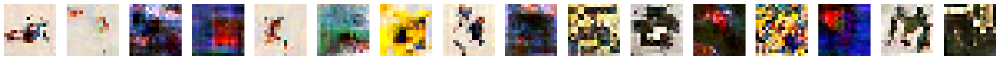

Found 306 files belonging to 1 classes.
STABLE
5000/5000 [==============================] - 639s 127ms/step - d_loss: -22.9158 - g_loss: 15.4517


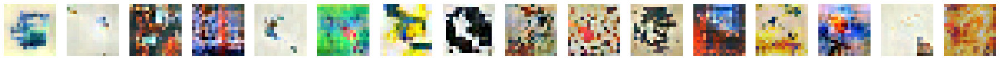

Found 306 files belonging to 1 classes.

Model resolution:32x32
TRANSITION
5000/5000 [==============================] - 721s 143ms/step - d_loss: -57.9669 - g_loss: 44.8731


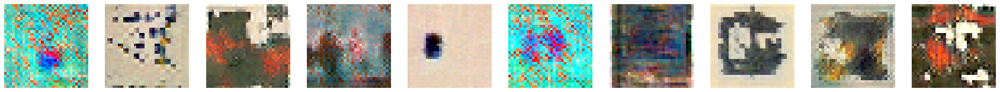

Found 306 files belonging to 1 classes.
STABLE
5000/5000 [==============================] - 8491s 2s/step - d_loss: -79.1917 - g_loss: 61.8109


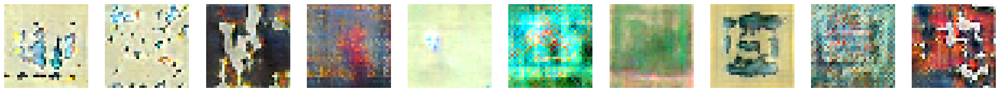

Found 306 files belonging to 1 classes.

Model resolution:64x64
TRANSITION
5000/5000 [==============================] - 917s 181ms/step - d_loss: -208.9415 - g_loss: 177.3948


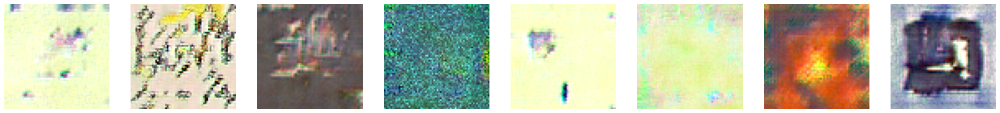

Found 306 files belonging to 1 classes.
STABLE
5000/5000 [==============================] - 864s 171ms/step - d_loss: -242.0950 - g_loss: 210.4344


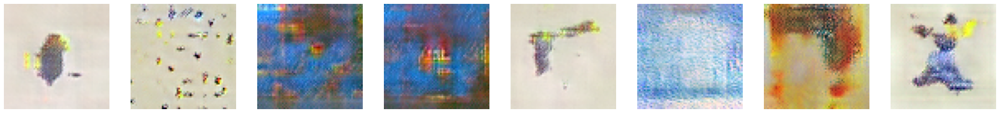

In [259]:
train(start_res=4, target_res=64, steps_per_epoch=5000, display_images=True)  #128, out=256, concate, dense 128 resnet with CNN x2

Found 21316 files belonging to 1 classes.

Model resolution:2x2
STABLE
2500/2500 [==============================] - 84s 32ms/step - d_loss: -1.9541 - g_loss: 1.5942


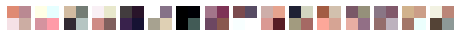

Found 21316 files belonging to 1 classes.

Model resolution:4x4
TRANSITION
5000/5000 [==============================] - 312s 61ms/step - d_loss: -2.1569 - g_loss: 1.7091


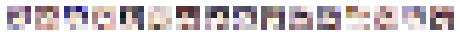

Found 21316 files belonging to 1 classes.
STABLE
5000/5000 [==============================] - 308s 61ms/step - d_loss: -1.4321 - g_loss: 0.9410


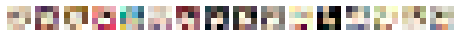

Found 21316 files belonging to 1 classes.

Model resolution:8x8
TRANSITION
5000/5000 [==============================] - 512s 100ms/step - d_loss: -1.9603 - g_loss: 2.6632


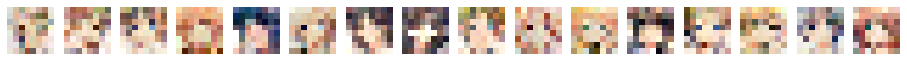

Found 21316 files belonging to 1 classes.
STABLE
5000/5000 [==============================] - 623s 124ms/step - d_loss: -1.1881 - g_loss: 0.7667


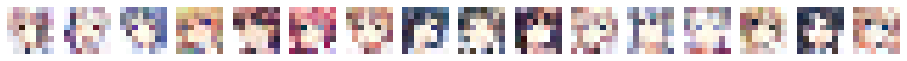

Found 21316 files belonging to 1 classes.

Model resolution:16x16
TRANSITION
5000/5000 [==============================] - 660s 130ms/step - d_loss: -1.7410 - g_loss: 1.5938


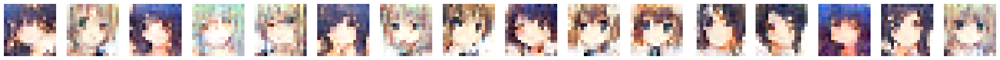

Found 21316 files belonging to 1 classes.
STABLE
5000/5000 [==============================] - 548s 109ms/step - d_loss: -1.4479 - g_loss: 0.5204


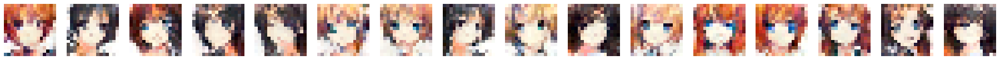

Found 21316 files belonging to 1 classes.

Model resolution:32x32
TRANSITION
5000/5000 [==============================] - 633s 124ms/step - d_loss: -2.0713 - g_loss: 2.1866


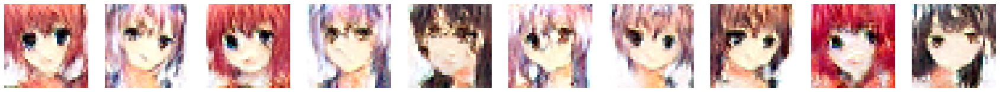

Found 21316 files belonging to 1 classes.
STABLE
5000/5000 [==============================] - 630s 125ms/step - d_loss: -2.8648 - g_loss: 1.9093


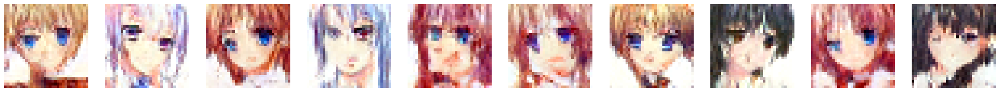

Found 21316 files belonging to 1 classes.

Model resolution:64x64
TRANSITION
5000/5000 [==============================] - 826s 162ms/step - d_loss: -8.4502 - g_loss: 8.0297


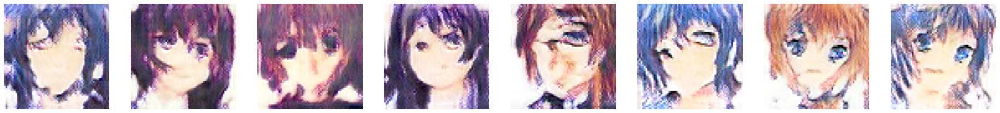

Found 21316 files belonging to 1 classes.
STABLE
5000/5000 [==============================] - 797s 158ms/step - d_loss: -7.2003 - g_loss: 6.2029


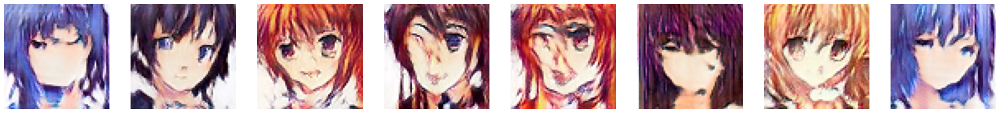

In [239]:
train(start_res=2, target_res=64, steps_per_epoch=5000, display_images=True)  #128, out=256, concate, dense 128 resnet with CNN x3

Found 21316 files belonging to 1 classes.

Model resolution:2x2
STABLE
2500/2500 [==============================] - 73s 28ms/step - d_loss: -1.7770 - g_loss: 1.9306


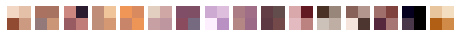

Found 21316 files belonging to 1 classes.

Model resolution:4x4
TRANSITION
5000/5000 [==============================] - 240s 46ms/step - d_loss: -3.9007 - g_loss: 3.3958


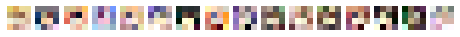

Found 21316 files belonging to 1 classes.
STABLE
5000/5000 [==============================] - 230s 45ms/step - d_loss: -2.0819 - g_loss: 1.66012s - d_loss


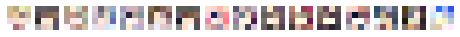

Found 21316 files belonging to 1 classes.

Model resolution:8x8
TRANSITION
5000/5000 [==============================] - 317s 62ms/step - d_loss: -2.5434 - g_loss: 2.5617


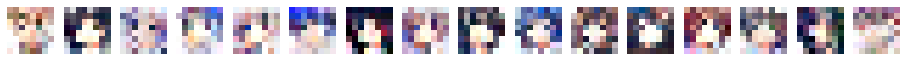

Found 21316 files belonging to 1 classes.
STABLE
5000/5000 [==============================] - 435s 86ms/step - d_loss: -2.2051 - g_loss: 1.7160


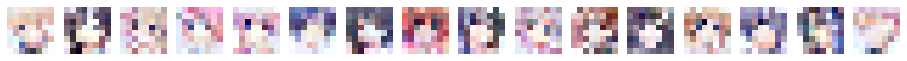

Found 21316 files belonging to 1 classes.

Model resolution:16x16
TRANSITION
5000/5000 [==============================] - 528s 104ms/step - d_loss: -5.1384 - g_loss: 4.5059


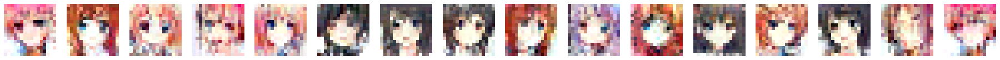

Found 21316 files belonging to 1 classes.
STABLE
5000/5000 [==============================] - 493s 98ms/step - d_loss: -4.1712 - g_loss: 3.1041


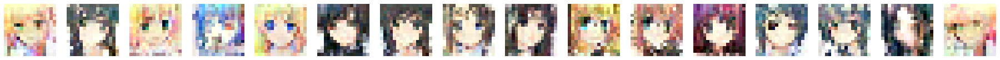

Found 21316 files belonging to 1 classes.

Model resolution:32x32
TRANSITION
5000/5000 [==============================] - 466s 92ms/step - d_loss: -9.6731 - g_loss: 7.7973


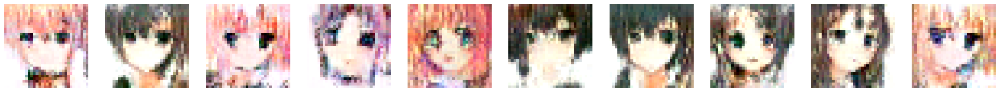

Found 21316 files belonging to 1 classes.
STABLE
5000/5000 [==============================] - 463s 92ms/step - d_loss: -7.7762 - g_loss: 5.5898


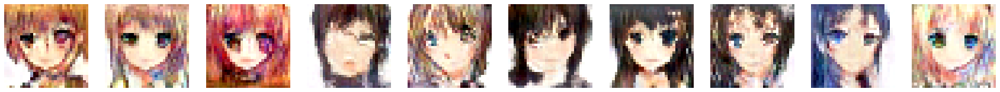

Found 21316 files belonging to 1 classes.

Model resolution:64x64
TRANSITION
5000/5000 [==============================] - 587s 116ms/step - d_loss: 4216.2744 - g_loss: 44.1331


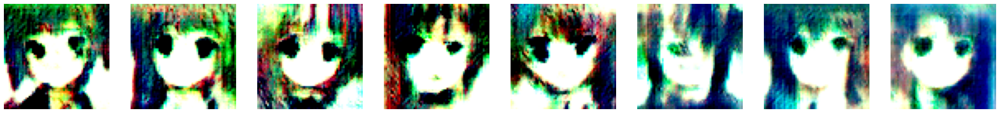

Found 21316 files belonging to 1 classes.
STABLE
5000/5000 [==============================] - 580s 115ms/step - d_loss: 6699407.0000 - g_loss: 1522.4150


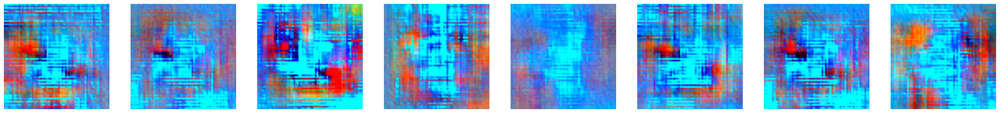

In [249]:
train(start_res=2, target_res=64, steps_per_epoch=5000, display_images=True)  #128, out=256, concate, dense 128 resnet with CNN x1

Found 21316 files belonging to 1 classes.

Model resolution:2x2
STABLE
2500/2500 [==============================] - 141s 55ms/step - d_loss: -1.8183 - g_loss: 1.4504


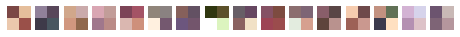

Found 21316 files belonging to 1 classes.

Model resolution:4x4
TRANSITION
5000/5000 [==============================] - 309s 59ms/step - d_loss: -2.2224 - g_loss: 2.5227


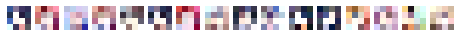

Found 21316 files belonging to 1 classes.
STABLE
5000/5000 [==============================] - 272s 54ms/step - d_loss: -0.8325 - g_loss: 1.0749


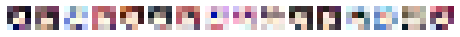

Found 21316 files belonging to 1 classes.

Model resolution:8x8
TRANSITION
5000/5000 [==============================] - 356s 70ms/step - d_loss: -1.0442 - g_loss: 2.7137


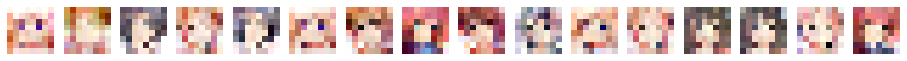

Found 21316 files belonging to 1 classes.
STABLE
5000/5000 [==============================] - 362s 72ms/step - d_loss: -1.0437 - g_loss: 1.4650


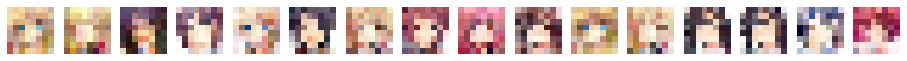

Found 21316 files belonging to 1 classes.

Model resolution:16x16
TRANSITION
5000/5000 [==============================] - 444s 87ms/step - d_loss: -1.6602 - g_loss: 2.5135


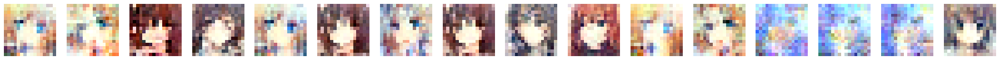

Found 21316 files belonging to 1 classes.
STABLE
5000/5000 [==============================] - 450s 89ms/step - d_loss: -1.6554 - g_loss: 1.06292s - d_loss: 


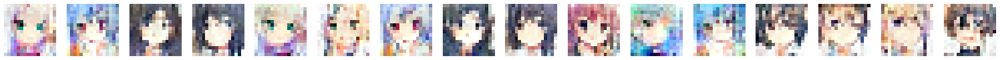

Found 21316 files belonging to 1 classes.

Model resolution:32x32
TRANSITION
5000/5000 [==============================] - 558s 110ms/step - d_loss: -3.2239 - g_loss: 2.9518


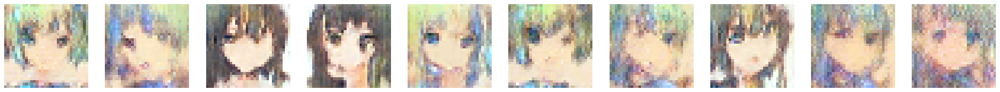

Found 21316 files belonging to 1 classes.
STABLE
5000/5000 [==============================] - 554s 110ms/step - d_loss: -2.6701 - g_loss: 1.4590


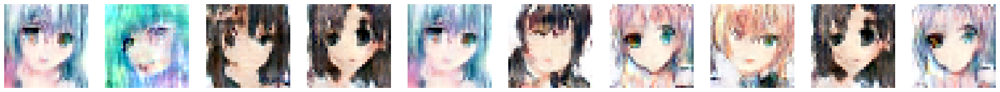

Found 21316 files belonging to 1 classes.

Model resolution:64x64
TRANSITION
5000/5000 [==============================] - 693s 136ms/step - d_loss: -9.9705 - g_loss: 8.8900


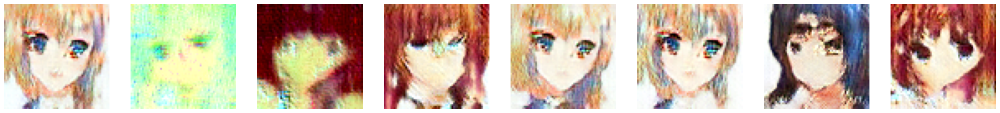

Found 21316 files belonging to 1 classes.
STABLE
5000/5000 [==============================] - 691s 137ms/step - d_loss: -9.2092 - g_loss: 7.7205


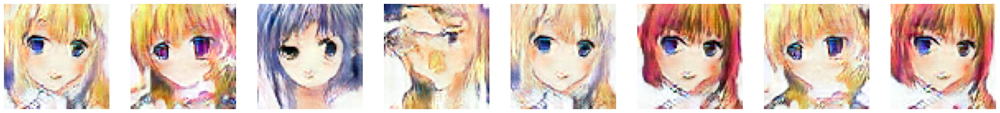

In [228]:
train(start_res=2, target_res=64, steps_per_epoch=5000, display_images=True)  #128, out=256, concate, dense 128 resnet with CNN x2

Found 21316 files belonging to 1 classes.

Model resolution:4x4
STABLE
5000/5000 [==============================] - 143s 28ms/step - d_loss: -8.4821 - g_loss: 5.0686


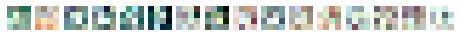

Found 21316 files belonging to 1 classes.

Model resolution:8x8
TRANSITION
5000/5000 [==============================] - 246s 48ms/step - d_loss: -5.8890 - g_loss: 4.5382


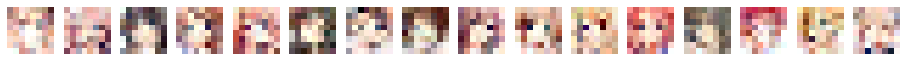

Found 21316 files belonging to 1 classes.
STABLE
5000/5000 [==============================] - 246s 49ms/step - d_loss: -3.0843 - g_loss: 2.4288


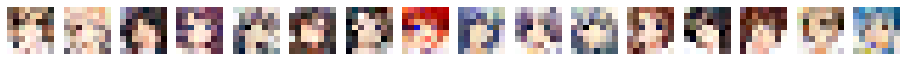

Found 21316 files belonging to 1 classes.

Model resolution:16x16
TRANSITION
5000/5000 [==============================] - 329s 65ms/step - d_loss: -3.4317 - g_loss: 3.4707


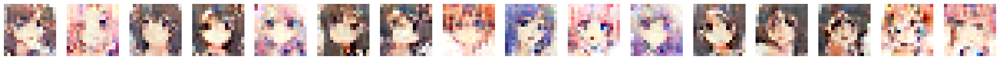

Found 21316 files belonging to 1 classes.
STABLE
5000/5000 [==============================] - 399s 79ms/step - d_loss: -2.2978 - g_loss: 1.8967


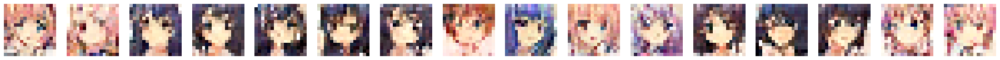

Found 21316 files belonging to 1 classes.

Model resolution:32x32
TRANSITION
5000/5000 [==============================] - 621s 123ms/step - d_loss: -3.6085 - g_loss: 3.2060


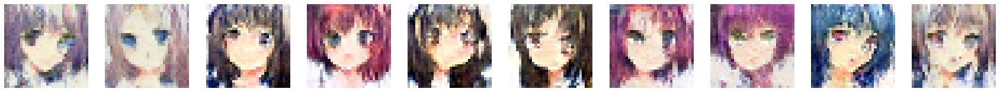

Found 21316 files belonging to 1 classes.
STABLE
5000/5000 [==============================] - 424s 84ms/step - d_loss: -3.4505 - g_loss: 2.9565


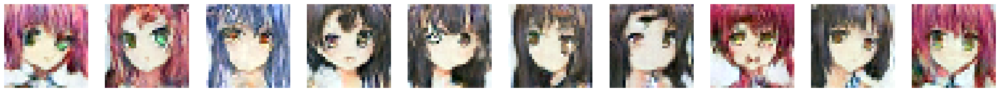

Found 21316 files belonging to 1 classes.

Model resolution:64x64
TRANSITION
5000/5000 [==============================] - 631s 125ms/step - d_loss: -10.7859 - g_loss: 7.9922


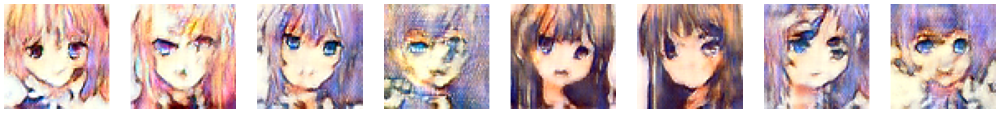

Found 21316 files belonging to 1 classes.
STABLE
5000/5000 [==============================] - 871s 173ms/step - d_loss: -12.1308 - g_loss: 9.5073


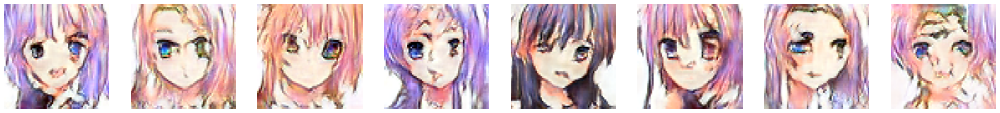

In [203]:
train(start_res=4, target_res=64, steps_per_epoch=5000, display_images=True)  #128, out=256, concate, dense 128 resnet with CNN x2

Found 21316 files belonging to 1 classes.

Model resolution:2x2
STABLE
1500/1500 [==============================] - 44s 27ms/step - d_loss: -1.7068 - g_loss: 2.5964


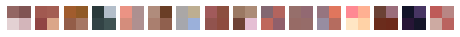

Found 21316 files belonging to 1 classes.

Model resolution:4x4
TRANSITION
3000/3000 [==============================] - 149s 48ms/step - d_loss: -2.4418 - g_loss: 3.2118


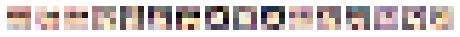

Found 21316 files belonging to 1 classes.
STABLE
3000/3000 [==============================] - 147s 48ms/step - d_loss: -1.5092 - g_loss: 1.2476


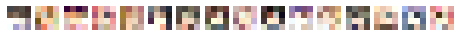

Found 21316 files belonging to 1 classes.

Model resolution:8x8
TRANSITION
3000/3000 [==============================] - 204s 66ms/step - d_loss: -2.1454 - g_loss: 2.5188


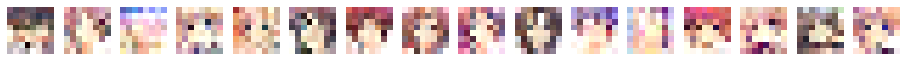

Found 21316 files belonging to 1 classes.
STABLE
3000/3000 [==============================] - 201s 66ms/step - d_loss: -1.8408 - g_loss: 0.8278


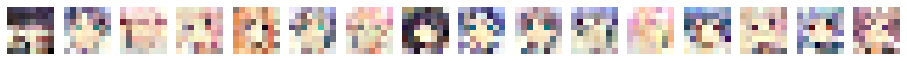

Found 21316 files belonging to 1 classes.

Model resolution:16x16
TRANSITION
3000/3000 [==============================] - 259s 84ms/step - d_loss: -4.1995 - g_loss: 4.4239


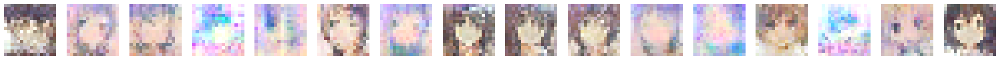

Found 21316 files belonging to 1 classes.
STABLE
3000/3000 [==============================] - 388s 128ms/step - d_loss: -3.5165 - g_loss: 2.1571


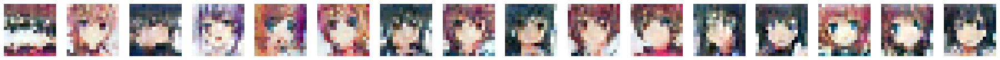

Found 21316 files belonging to 1 classes.

Model resolution:32x32
TRANSITION
3000/3000 [==============================] - 495s 163ms/step - d_loss: -4.8459 - g_loss: 5.1890


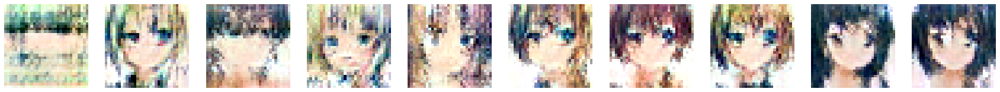

Found 21316 files belonging to 1 classes.
STABLE
3000/3000 [==============================] - 314s 103ms/step - d_loss: -4.7033 - g_loss: 3.1234


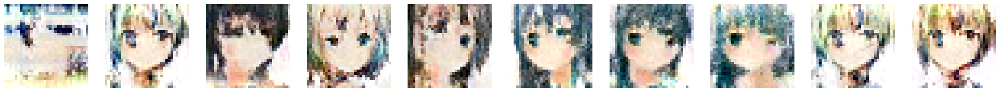

Found 21316 files belonging to 1 classes.

Model resolution:64x64
TRANSITION
3000/3000 [==============================] - 373s 122ms/step - d_loss: -15.5111 - g_loss: 11.9091


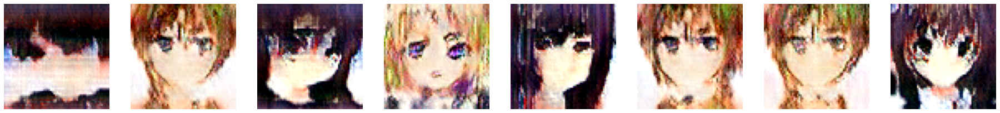

Found 21316 files belonging to 1 classes.
STABLE
3000/3000 [==============================] - 430s 142ms/step - d_loss: -16.3078 - g_loss: 11.6857


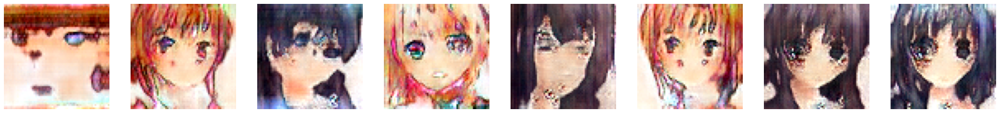

In [198]:
train(start_res=2, target_res=64, steps_per_epoch=3000, display_images=True)  #128, out=256, concate, dense 128 resnet

Found 21316 files belonging to 1 classes.

Model resolution:2x2
STABLE
1500/1500 [==============================] - 44s 27ms/step - d_loss: -1.6932 - g_loss: 2.6840


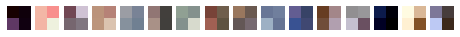

Found 21316 files belonging to 1 classes.

Model resolution:4x4
TRANSITION
3000/3000 [==============================] - 148s 47ms/step - d_loss: -2.5321 - g_loss: 3.51142s - d_loss


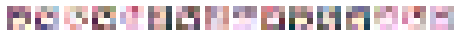

Found 21316 files belonging to 1 classes.
STABLE
3000/3000 [==============================] - 146s 48ms/step - d_loss: -1.5207 - g_loss: 1.1525


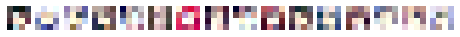

Found 21316 files belonging to 1 classes.

Model resolution:8x8
TRANSITION
3000/3000 [==============================] - 201s 65ms/step - d_loss: -2.6275 - g_loss: 2.3037


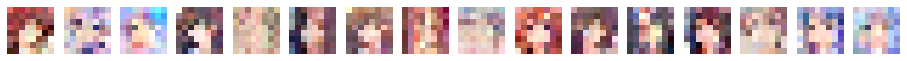

Found 21316 files belonging to 1 classes.
STABLE
3000/3000 [==============================] - 201s 66ms/step - d_loss: -2.0442 - g_loss: 1.3129


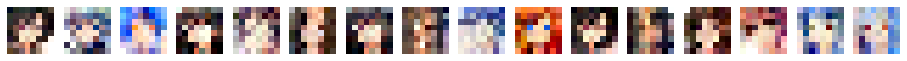

Found 21316 files belonging to 1 classes.

Model resolution:16x16
TRANSITION
3000/3000 [==============================] - 241s 78ms/step - d_loss: -4.6111 - g_loss: 3.3484


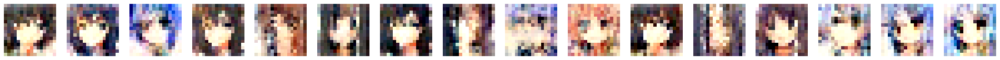

Found 21316 files belonging to 1 classes.
STABLE
3000/3000 [==============================] - 239s 78ms/step - d_loss: -3.8628 - g_loss: 2.2734


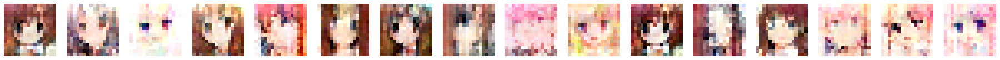

Found 21316 files belonging to 1 classes.

Model resolution:32x32
TRANSITION
3000/3000 [==============================] - 297s 97ms/step - d_loss: -7.8132 - g_loss: 6.1794


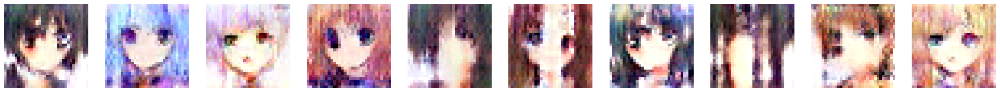

Found 21316 files belonging to 1 classes.
STABLE
3000/3000 [==============================] - 294s 97ms/step - d_loss: -5.5477 - g_loss: 3.7197


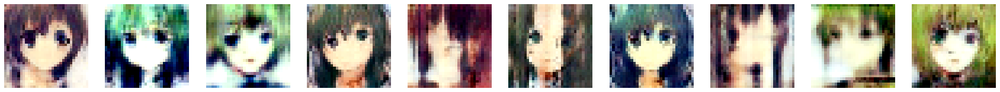

Found 21316 files belonging to 1 classes.

Model resolution:64x64
TRANSITION
3000/3000 [==============================] - 376s 123ms/step - d_loss: -20.8449 - g_loss: 15.5369


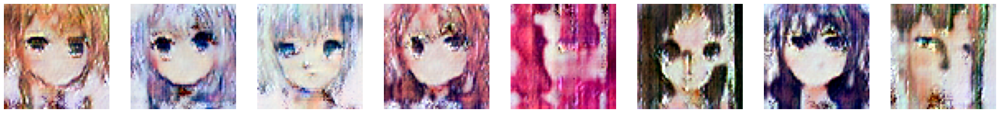

Found 21316 files belonging to 1 classes.
STABLE
3000/3000 [==============================] - 373s 123ms/step - d_loss: -19.6270 - g_loss: 13.2475


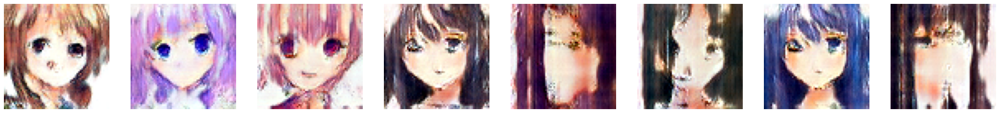

In [190]:
train(start_res=2, target_res=64, steps_per_epoch=3000, display_images=True)   #128, out=256, back = 128, concate resnet

Found 21316 files belonging to 1 classes.

Model resolution:2x2
STABLE
1500/1500 [==============================] - 102s 65ms/step - d_loss: -1.7194 - g_loss: 2.6761


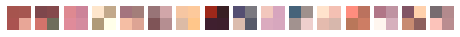

Found 21316 files belonging to 1 classes.

Model resolution:4x4
TRANSITION
3000/3000 [==============================] - 113s 35ms/step - d_loss: -2.7252 - g_loss: 3.3461


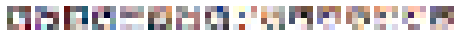

Found 21316 files belonging to 1 classes.
STABLE
3000/3000 [==============================] - 111s 36ms/step - d_loss: -1.2341 - g_loss: 1.7496


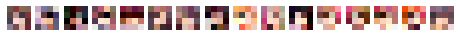

Found 21316 files belonging to 1 classes.

Model resolution:8x8
TRANSITION
3000/3000 [==============================] - 140s 45ms/step - d_loss: -2.4646 - g_loss: 1.49825s - d_loss: -2.4


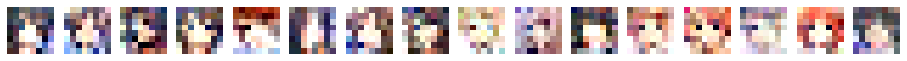

Found 21316 files belonging to 1 classes.
STABLE
3000/3000 [==============================] - 138s 45ms/step - d_loss: -2.5105 - g_loss: 1.2476


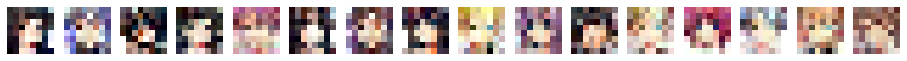

Found 21316 files belonging to 1 classes.

Model resolution:16x16
TRANSITION
3000/3000 [==============================] - 171s 55ms/step - d_loss: -5.0098 - g_loss: 4.2236


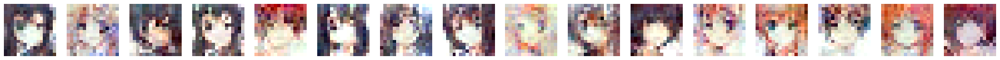

Found 21316 files belonging to 1 classes.
STABLE
3000/3000 [==============================] - 167s 54ms/step - d_loss: -4.1000 - g_loss: 3.8457


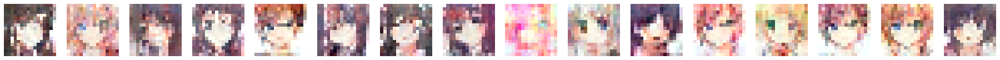

Found 21316 files belonging to 1 classes.

Model resolution:32x32
TRANSITION
3000/3000 [==============================] - 204s 66ms/step - d_loss: -7.5120 - g_loss: 6.1043


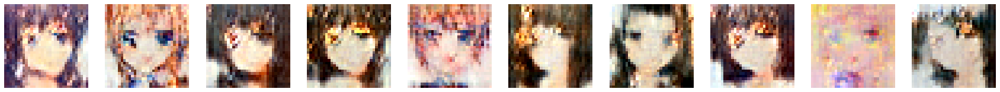

Found 21316 files belonging to 1 classes.
STABLE
3000/3000 [==============================] - 202s 66ms/step - d_loss: -5.1737 - g_loss: 3.1650


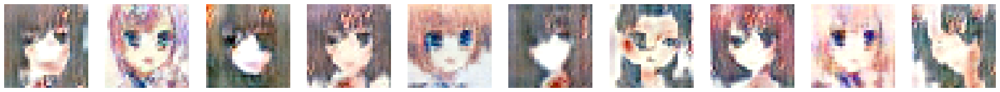

Found 21316 files belonging to 1 classes.

Model resolution:64x64
TRANSITION
3000/3000 [==============================] - 306s 99ms/step - d_loss: -16.9389 - g_loss: 14.0630


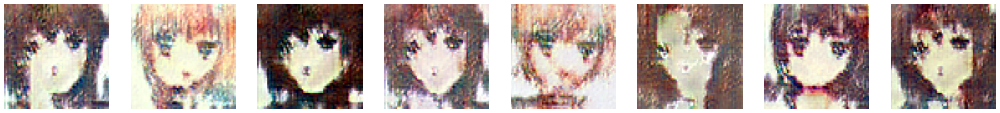

Found 21316 files belonging to 1 classes.
STABLE
3000/3000 [==============================] - 433s 143ms/step - d_loss: -13.5434 - g_loss: 9.6903


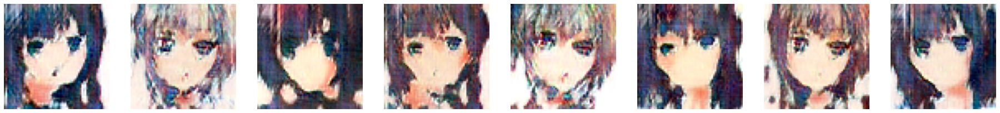

In [177]:
train(start_res=2, target_res=64, steps_per_epoch=3000, display_images=True) #different layer different style

Found 21316 files belonging to 1 classes.

Model resolution:2x2
STABLE
1500/1500 [==============================] - 46s 29ms/step - d_loss: -2.0023 - g_loss: 3.4028


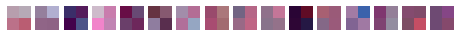

Found 21316 files belonging to 1 classes.

Model resolution:4x4
TRANSITION
3000/3000 [==============================] - 110s 35ms/step - d_loss: -3.2472 - g_loss: 3.8857


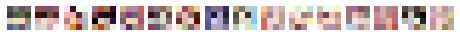

Found 21316 files belonging to 1 classes.
STABLE
3000/3000 [==============================] - 109s 35ms/step - d_loss: -2.4838 - g_loss: 1.5875


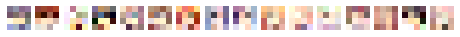

Found 21316 files belonging to 1 classes.

Model resolution:8x8
TRANSITION
3000/3000 [==============================] - 137s 44ms/step - d_loss: -5.7688 - g_loss: 4.9945


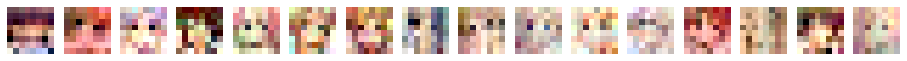

Found 21316 files belonging to 1 classes.
STABLE
3000/3000 [==============================] - 131s 43ms/step - d_loss: -3.7759 - g_loss: 3.7094


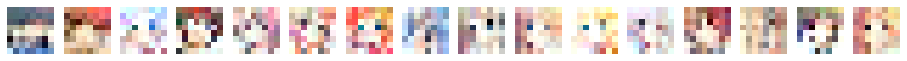

Found 21316 files belonging to 1 classes.

Model resolution:16x16
TRANSITION
3000/3000 [==============================] - 169s 54ms/step - d_loss: -6.4126 - g_loss: 7.1374


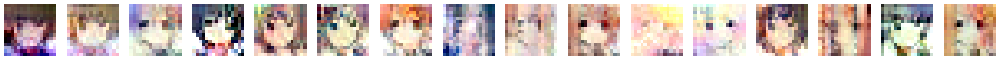

Found 21316 files belonging to 1 classes.
STABLE
3000/3000 [==============================] - 165s 54ms/step - d_loss: -4.3295 - g_loss: 3.9156


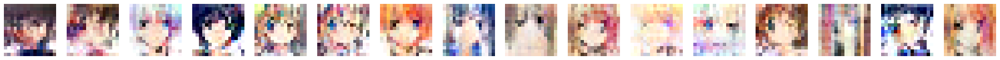

Found 21316 files belonging to 1 classes.

Model resolution:32x32
TRANSITION
3000/3000 [==============================] - 203s 65ms/step - d_loss: -11.1414 - g_loss: 8.4636


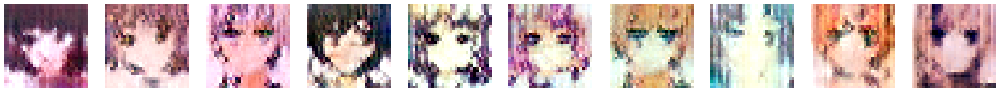

Found 21316 files belonging to 1 classes.
STABLE
3000/3000 [==============================] - 195s 64ms/step - d_loss: -7.5527 - g_loss: 5.0699


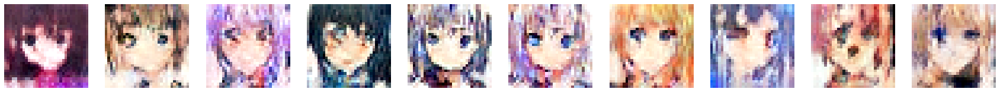

Found 21316 files belonging to 1 classes.

Model resolution:64x64
TRANSITION
3000/3000 [==============================] - 241s 77ms/step - d_loss: -21.2759 - g_loss: 18.0713


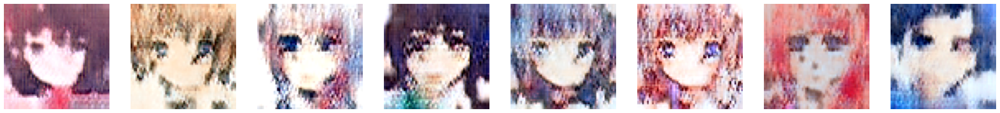

Found 21316 files belonging to 1 classes.
STABLE
3000/3000 [==============================] - 247s 81ms/step - d_loss: -20.5038 - g_loss: 13.0271


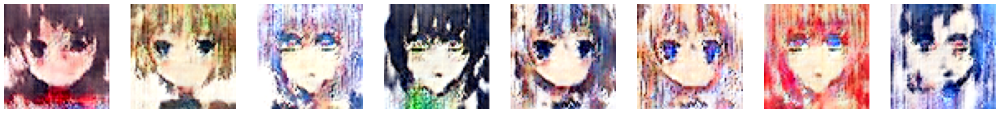

In [134]:
train(start_res=2, target_res=64, steps_per_epoch=3000, display_images=True)

Found 21316 files belonging to 1 classes.

Model resolution:2x2
STABLE
3000/3000 [==============================] - 86s 27ms/step - d_loss: -3.0913 - g_loss: 2.7194


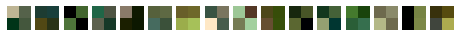

Found 21316 files belonging to 1 classes.

Model resolution:4x4
TRANSITION
6000/6000 [==============================] - 219s 36ms/step - d_loss: -3.2506 - g_loss: 3.3391


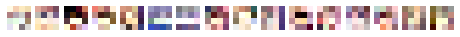

Found 21316 files belonging to 1 classes.
STABLE
6000/6000 [==============================] - 217s 36ms/step - d_loss: -2.3548 - g_loss: 2.0827


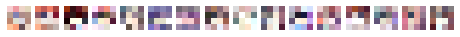

Found 21316 files belonging to 1 classes.

Model resolution:8x8
TRANSITION
6000/6000 [==============================] - 270s 44ms/step - d_loss: -3.2846 - g_loss: 4.33403


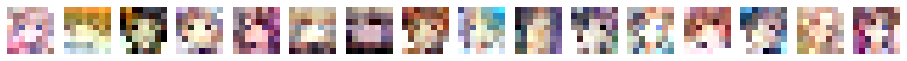

Found 21316 files belonging to 1 classes.
STABLE
6000/6000 [==============================] - 264s 44ms/step - d_loss: -1.3860 - g_loss: 2.69810s - d_loss: -1.3834 - g_loss: 2


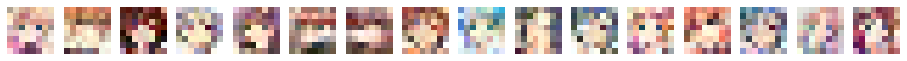

Found 21316 files belonging to 1 classes.

Model resolution:16x16
TRANSITION
6000/6000 [==============================] - 332s 54ms/step - d_loss: -5.9634 - g_loss: 5.1862


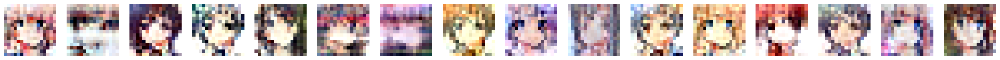

Found 21316 files belonging to 1 classes.
STABLE
6000/6000 [==============================] - 326s 54ms/step - d_loss: -2.9519 - g_loss: 3.63570s - d_loss: -2.950


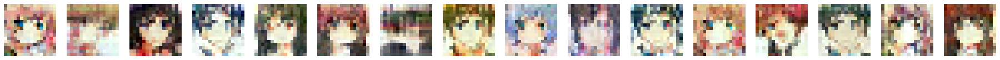

Found 21316 files belonging to 1 classes.

Model resolution:32x32
TRANSITION
6000/6000 [==============================] - 409s 67ms/step - d_loss: -2.2814 - g_loss: 6.2098


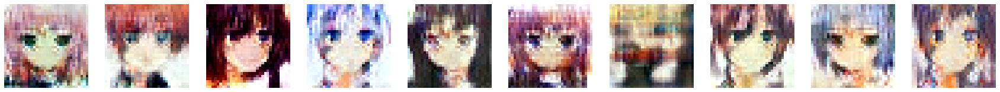

Found 21316 files belonging to 1 classes.
STABLE
6000/6000 [==============================] - 414s 68ms/step - d_loss: -4.6041 - g_loss: 3.5214


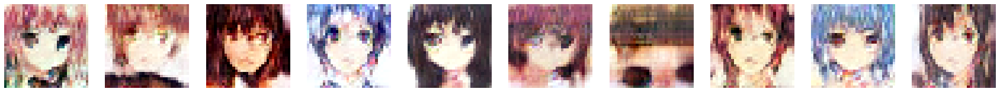

Found 21316 files belonging to 1 classes.

Model resolution:64x64
TRANSITION
2884/6000 [=============>................] - ETA: 4:03 - d_loss: -14.4841 - g_loss: 15.1720

KeyboardInterrupt: 

In [119]:
train(start_res=2, target_res=64, steps_per_epoch=6000, display_images=True)   #1024 latent space

Found 21551 files belonging to 1 classes.

Model resolution:2x2
STABLE
2500/2500 [==============================] - 72s 28ms/step - d_loss: -2.1626 - g_loss: 2.2491


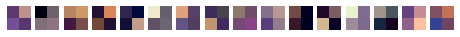

Found 21551 files belonging to 1 classes.

Model resolution:4x4
TRANSITION
5000/5000 [==============================] - 180s 35ms/step - d_loss: -3.0933 - g_loss: 3.2206


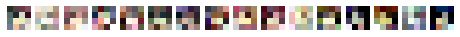

Found 21551 files belonging to 1 classes.
STABLE
5000/5000 [==============================] - 176s 35ms/step - d_loss: -2.2670 - g_loss: 1.9243


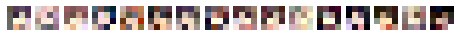

Found 21551 files belonging to 1 classes.

Model resolution:8x8
TRANSITION
5000/5000 [==============================] - 221s 43ms/step - d_loss: -3.9418 - g_loss: 3.8339


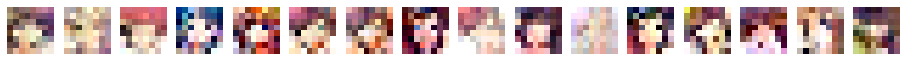

Found 21551 files belonging to 1 classes.
STABLE
5000/5000 [==============================] - 215s 42ms/step - d_loss: -1.2722 - g_loss: 2.5145


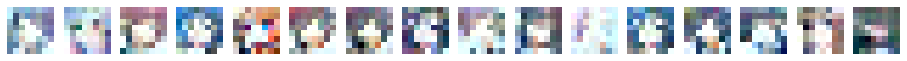

Found 21551 files belonging to 1 classes.

Model resolution:16x16
TRANSITION
5000/5000 [==============================] - 272s 53ms/step - d_loss: -5.8296 - g_loss: 4.9946


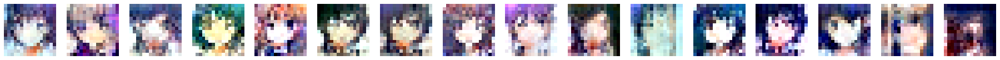

Found 21551 files belonging to 1 classes.
STABLE
5000/5000 [==============================] - 270s 53ms/step - d_loss: -4.1057 - g_loss: 3.0306


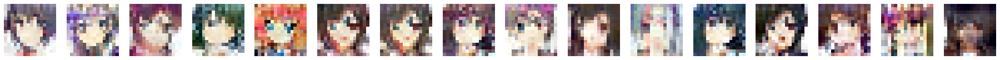

Found 21551 files belonging to 1 classes.

Model resolution:32x32
TRANSITION
5000/5000 [==============================] - 323s 63ms/step - d_loss: -10.1190 - g_loss: 7.4561


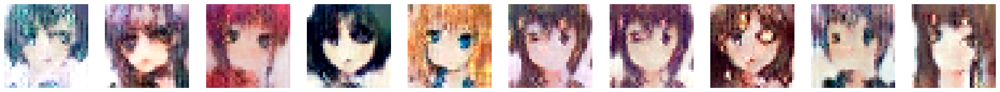

Found 21551 files belonging to 1 classes.
STABLE
5000/5000 [==============================] - 327s 65ms/step - d_loss: -6.6631 - g_loss: 4.5028


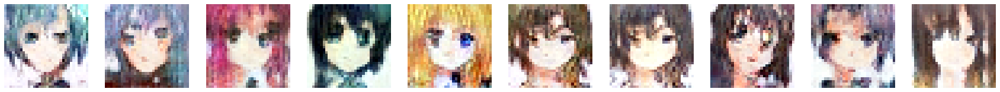

Found 21551 files belonging to 1 classes.

Model resolution:64x64
TRANSITION
5000/5000 [==============================] - 392s 77ms/step - d_loss: -16.5857 - g_loss: 14.6437


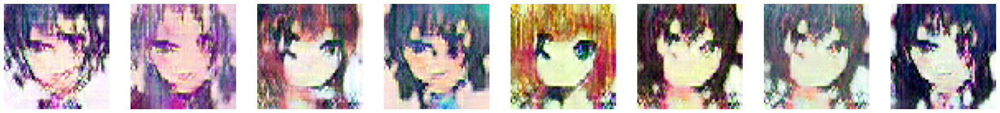

Found 21551 files belonging to 1 classes.
STABLE
5000/5000 [==============================] - 393s 78ms/step - d_loss: -11.8565 - g_loss: 9.9304


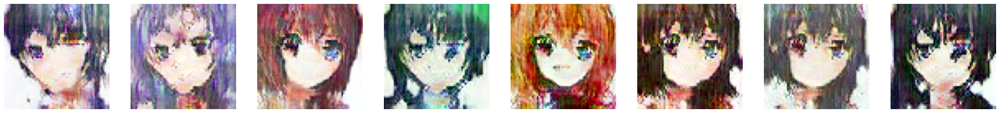

In [114]:
train(start_res=2, target_res=64, steps_per_epoch=5000, display_images=True)     #256 latent space

Found 21551 files belonging to 1 classes.

Model resolution:2x2
STABLE
2500/2500 [==============================] - 77s 30ms/step - d_loss: -2.6266 - g_loss: 2.2462


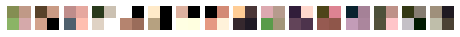

Found 21551 files belonging to 1 classes.

Model resolution:4x4
TRANSITION
5000/5000 [==============================] - 193s 38ms/step - d_loss: -2.9180 - g_loss: 2.2779


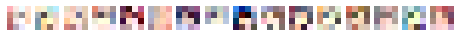

Found 21551 files belonging to 1 classes.
STABLE
5000/5000 [==============================] - 195s 39ms/step - d_loss: -2.2571 - g_loss: 1.5452


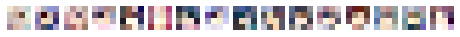

Found 21551 files belonging to 1 classes.

Model resolution:8x8
TRANSITION
5000/5000 [==============================] - 236s 46ms/step - d_loss: -2.8512 - g_loss: 4.0703


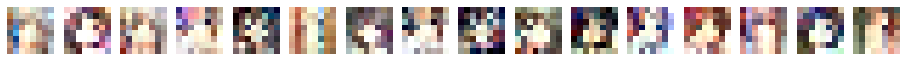

Found 21551 files belonging to 1 classes.
STABLE
5000/5000 [==============================] - 236s 47ms/step - d_loss: 2.0482 - g_loss: 2.2276


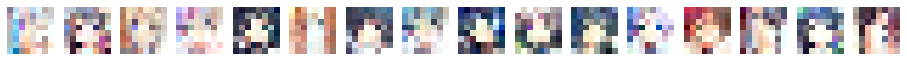

Found 21551 files belonging to 1 classes.

Model resolution:16x16
TRANSITION
5000/5000 [==============================] - 279s 55ms/step - d_loss: -2.8871 - g_loss: 3.9844


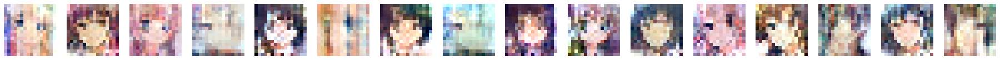

Found 21551 files belonging to 1 classes.
STABLE
5000/5000 [==============================] - 275s 54ms/step - d_loss: -3.9757 - g_loss: 2.3130


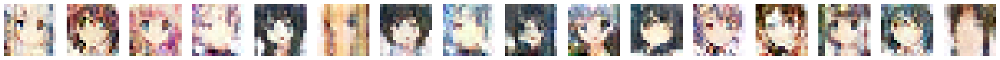

Found 21551 files belonging to 1 classes.

Model resolution:32x32
TRANSITION
5000/5000 [==============================] - 329s 64ms/step - d_loss: -8.0683 - g_loss: 5.9303


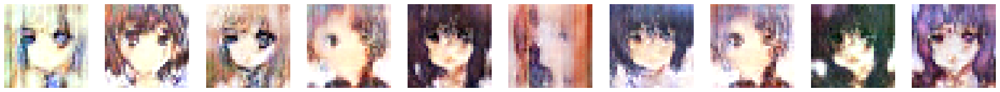

Found 21551 files belonging to 1 classes.
STABLE
5000/5000 [==============================] - 526s 104ms/step - d_loss: -6.4709 - g_loss: 4.8603


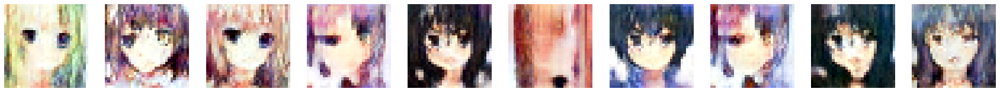

Found 21551 files belonging to 1 classes.

Model resolution:64x64
TRANSITION
5000/5000 [==============================] - 674s 133ms/step - d_loss: -13.3791 - g_loss: 12.2596


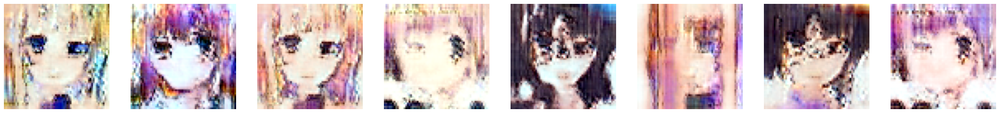

Found 21551 files belonging to 1 classes.
STABLE
5000/5000 [==============================] - 673s 134ms/step - d_loss: -15.5377 - g_loss: 11.5217


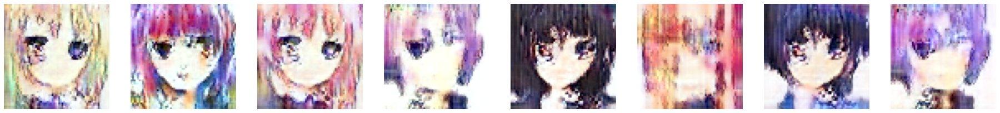

In [76]:
train(start_res=2, target_res=64, steps_per_epoch=5000, display_images=True)        #latent space 512

Found 21551 files belonging to 1 classes.

Model resolution:2x2
STABLE
2500/2500 [==============================] - 74s 29ms/step - d_loss: -2.2945 - g_loss: 2.1263 0s - d_loss: -2.2999 


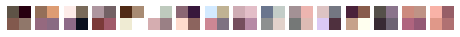

Found 21551 files belonging to 1 classes.

Model resolution:4x4
TRANSITION
5000/5000 [==============================] - 211s 40ms/step - d_loss: -2.6833 - g_loss: 2.7542


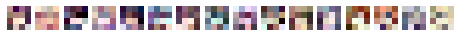

Found 21551 files belonging to 1 classes.
STABLE
5000/5000 [==============================] - 204s 40ms/step - d_loss: -1.7395 - g_loss: 1.5014


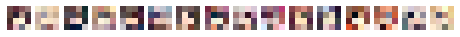

Found 21551 files belonging to 1 classes.

Model resolution:8x8
TRANSITION
5000/5000 [==============================] - 270s 52ms/step - d_loss: -2.4995 - g_loss: 2.9114


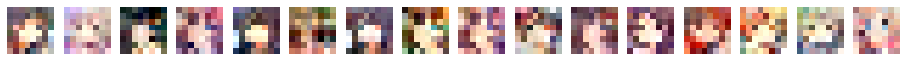

Found 21551 files belonging to 1 classes.
STABLE
5000/5000 [==============================] - 389s 77ms/step - d_loss: -1.0078 - g_loss: 1.7149


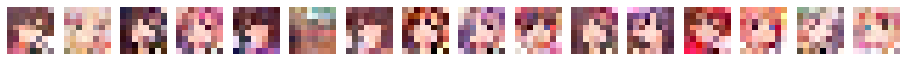

Found 21551 files belonging to 1 classes.

Model resolution:16x16
TRANSITION
5000/5000 [==============================] - 446s 87ms/step - d_loss: -2.9322 - g_loss: 3.8481


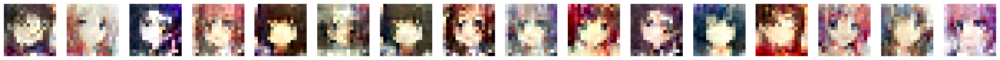

Found 21551 files belonging to 1 classes.
STABLE
5000/5000 [==============================] - 322s 64ms/step - d_loss: -2.7037 - g_loss: 1.8348


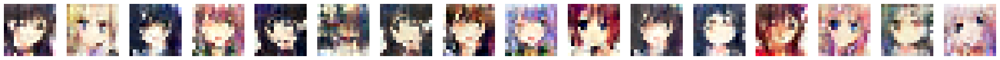

Found 21551 files belonging to 1 classes.

Model resolution:32x32
TRANSITION
5000/5000 [==============================] - 387s 75ms/step - d_loss: -5.9088 - g_loss: 4.0782


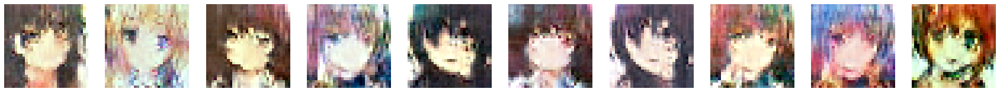

Found 21551 files belonging to 1 classes.
STABLE
5000/5000 [==============================] - 387s 76ms/step - d_loss: -4.8498 - g_loss: 2.9488


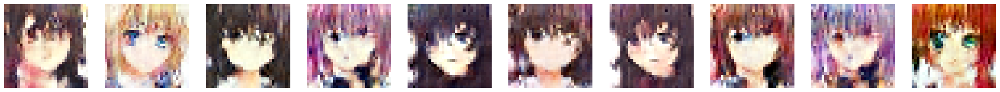

Found 21551 files belonging to 1 classes.

Model resolution:64x64
TRANSITION
5000/5000 [==============================] - 478s 93ms/step - d_loss: -10.5878 - g_loss: 9.3977


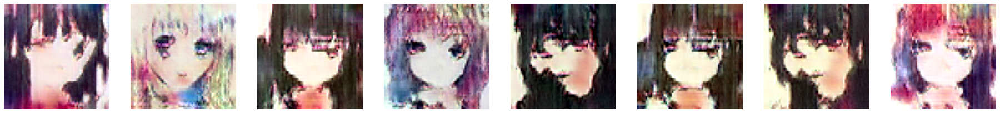

Found 21551 files belonging to 1 classes.
STABLE
5000/5000 [==============================] - 764s 152ms/step - d_loss: -12.2617 - g_loss: 9.2945


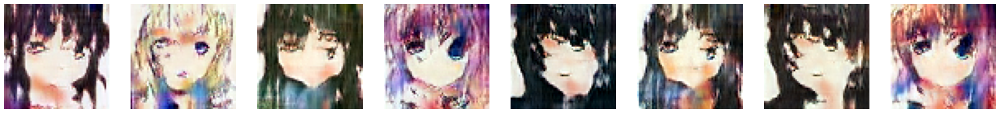

In [71]:
train(start_res=2, target_res=64, steps_per_epoch=5000, display_images=True)      #start from 2

Found 21551 files belonging to 1 classes.

Model resolution:4x4
STABLE
5000/5000 [==============================] - 213s 40ms/step - d_loss: -7.8057 - g_loss: 5.0359


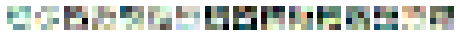

Found 21551 files belonging to 1 classes.

Model resolution:8x8
TRANSITION
5000/5000 [==============================] - 254s 49ms/step - d_loss: -7.4522 - g_loss: 5.08941s - d_loss: -7.


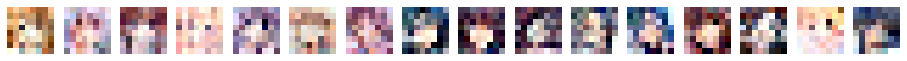

Found 21551 files belonging to 1 classes.
STABLE
5000/5000 [==============================] - 249s 49ms/step - d_loss: -4.7480 - g_loss: 3.15492s -


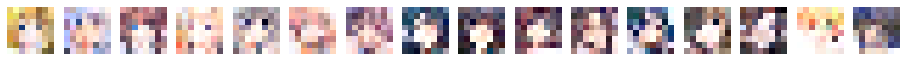

Found 21551 files belonging to 1 classes.

Model resolution:16x16
TRANSITION
5000/5000 [==============================] - 328s 64ms/step - d_loss: -6.9698 - g_loss: 5.34811s - d_los


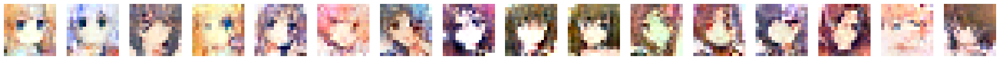

Found 21551 files belonging to 1 classes.
STABLE
5000/5000 [==============================] - 308s 61ms/step - d_loss: -2.4454 - g_loss: 2.4497


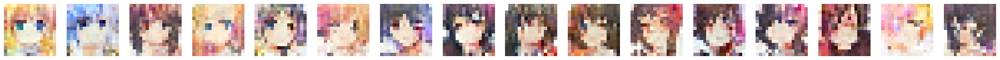

Found 21551 files belonging to 1 classes.

Model resolution:32x32
TRANSITION
5000/5000 [==============================] - 439s 86ms/step - d_loss: -6.6889 - g_loss: 5.3517


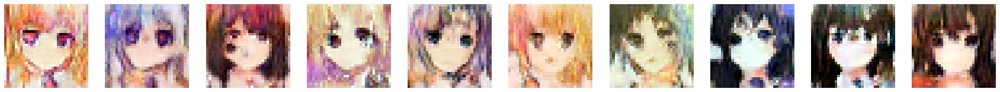

Found 21551 files belonging to 1 classes.
STABLE
5000/5000 [==============================] - 759s 151ms/step - d_loss: -5.3688 - g_loss: 4.3757


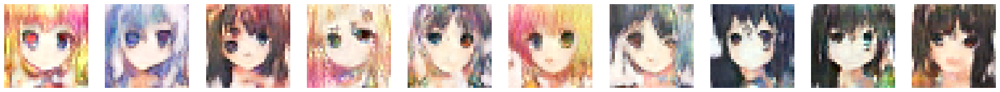

Found 21551 files belonging to 1 classes.

Model resolution:64x64
TRANSITION
5000/5000 [==============================] - 926s 183ms/step - d_loss: -15.5967 - g_loss: 13.0720


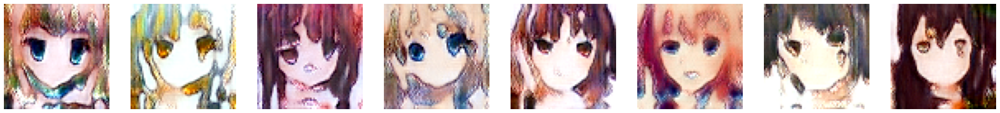

Found 21551 files belonging to 1 classes.
STABLE
5000/5000 [==============================] - 970s 193ms/step - d_loss: -16.3742 - g_loss: 12.6688


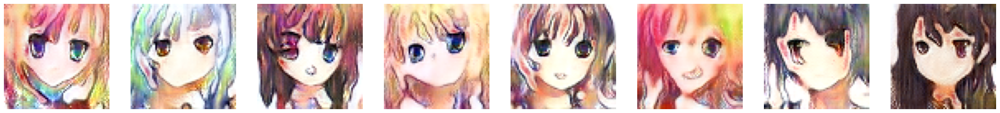

In [10]:
train(start_res=4, target_res=64, steps_per_epoch=5000, display_images=True)

Found 21551 files belonging to 1 classes.
STABLE
5000/5000 [==============================] - 651s 129ms/step - d_loss: -12.1016 - g_loss: 8.6233


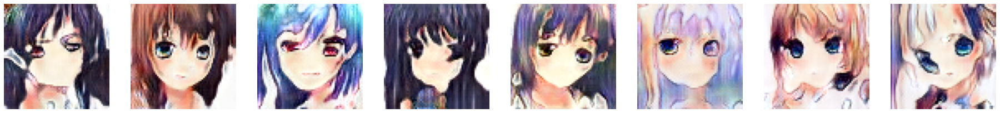

In [41]:
train(start_res=64, target_res=64, steps_per_epoch=5000, display_images=True)

Found 21551 files belonging to 1 classes.
STABLE
5000/5000 [==============================] - 760s 151ms/step - d_loss: -12.0588 - g_loss: 8.1750


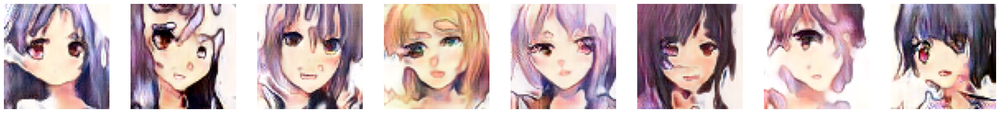

In [42]:
train(start_res=64, target_res=64, steps_per_epoch=5000, display_images=True)

Found 21551 files belonging to 1 classes.
STABLE
5000/5000 [==============================] - 770s 153ms/step - d_loss: -10.7343 - g_loss: 7.3778


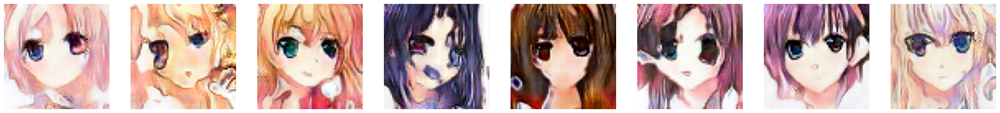

In [43]:
train(start_res=64, target_res=64, steps_per_epoch=5000, display_images=True)

Found 21551 files belonging to 1 classes.
STABLE
5000/5000 [==============================] - 724s 144ms/step - d_loss: -8.7234 - g_loss: 5.9482


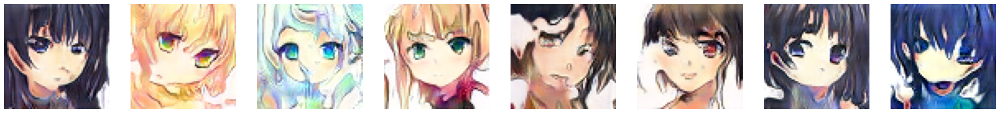

In [57]:
train(start_res=64, target_res=64, steps_per_epoch=5000, display_images=True)

In [58]:
for i in style_gan.g_builder.g_blocks:
    i.summary()

Model: "genblock_4x4"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
g_4 (InputLayer)                [(None, 4, 4, 512)]  0                                            
__________________________________________________________________________________________________
noise_4 (InputLayer)            [(None, 4, 4, 1)]    0                                            
__________________________________________________________________________________________________
add_noise (AddNoise)            (None, 4, 4, 512)    512         g_4[0][0]                        
                                                                 noise_4[0][0]                    
__________________________________________________________________________________________________
leaky_re_lu_23 (LeakyReLU)      (None, 4, 4, 512)    0           add_noise[0][0]       

In [55]:
style_gan.mapping.summary()

Model: "mapping"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 512)]        0                                            
__________________________________________________________________________________________________
tf.math.pow (TFOpLambda)        (None, 512)          0           input_1[0][0]                    
__________________________________________________________________________________________________
tf.math.reduce_mean (TFOpLambda (None, 1)            0           tf.math.pow[0][0]                
__________________________________________________________________________________________________
tf.__operators__.add_2 (TFOpLam (None, 1)            0           tf.math.reduce_mean[0][0]        
____________________________________________________________________________________________